In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import os

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from sklearn.metrics import adjusted_rand_score as ARI
from sklearn.metrics import adjusted_mutual_info_score as AMI

from scipy import sparse
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
rcParams['figure.figsize'] = (7,7)
import seaborn as sns
from scipy import sparse
# import muon as mu
# Import a module with ATAC-seq-related functions
# from muon import atac as ac
sc.settings.verbosity =0

In [3]:
import episcanpy as epi

In [4]:
sample_color_dic = {'lib_09': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 'lib_10': (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 'lib_15': (1.0, 0.4980392156862745, 0.054901960784313725),
 'lib_23': (1.0, 0.7333333333333333, 0.47058823529411764),
 'lib_29': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 'lib_34': (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 'lib_36': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 'lib_38': (1.0, 0.596078431372549, 0.5882352941176471),
 'lib_51': (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 'lib_54': (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 'lib_55': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 'lib_56': (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 'lib_57': (0.8901960784313725, 0.4666666666666667, 0.7607843137254902)}

def comparison_heatmap(adata, key1, key2, label_1=None, label_2=None, cmap = 'Reds', annot = True, figsize=(7,7)):
    if label_1==None:
        label_1=key1
    if label_2==None:
        label_2=key2
    expected_df = adata.obs[[key1,key2]].groupby(by=[key2,key1]).size().reset_index(name = 'count')
    counts = np.array(expected_df['count'].tolist())
    df = pd.DataFrame(counts.reshape(((len(adata.obs[key2].cat.categories),len(adata.obs[key1].cat.categories)))), index = expected_df[key2].unique(), columns = expected_df[key1].unique())
    if annot ==True:
        annot_ = df.astype(int)
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    else:
        annot_=None
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    s = sns.heatmap(df/np.sum(df,axis = 0), cbar_kws={'label': '% cell shared between annotations'}, cmap=cmap, vmax=1, vmin=0, annot = annot_,  fmt='.5g')
    s.set_ylabel(label_2, fontsize=12)
    s.set_xlabel(label_1, fontsize = 12)
    return df
def comparison_heatmap_percent(adata, key1, key2, label_1=None, label_2=None, cmap = 'Reds', annot = True, figsize=(7,7)):
    if label_1==None:
        label_1=key1
    if label_2==None:
        label_2=key2
    expected_df = adata.obs[[key1,key2]].groupby(by=[key2,key1]).size().reset_index(name = 'count')
    counts = np.array(expected_df['count'].tolist())
    df = pd.DataFrame(counts.reshape(((len(adata.obs[key2].cat.categories),len(adata.obs[key1].cat.categories)))), index = expected_df[key2].unique(), columns = expected_df[key1].unique())
    if annot ==True:
        annot_ = df.astype(int)
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    else:
        annot_=None
        sc.settings.set_figure_params(figsize=figsize, color_map='gist_earth')
    s = sns.heatmap(df/np.sum(df,axis = 0), cbar_kws={'label': '% cell shared between annotations'}, cmap=cmap, vmax=1, vmin=0, annot = annot_/np.sum(df,axis = 0),  fmt='.2g')
    s.set_ylabel(label_2, fontsize=12)
    s.set_xlabel(label_1, fontsize = 12)
    return df/np.sum(df,axis = 0)
def n_cells_histogram(adata, sample_key='sample', sample_color_dic = sample_color_dic):
    df = pd.DataFrame(adata.obs[sample_key].value_counts().index, index = adata.obs[sample_key].value_counts().index  , columns =[ sample_key ])
    df['n_cells'] = adata.obs[sample_key].value_counts().values.astype(int)
    df.reindex(index=np.argsort(df['n_cells']).index.tolist()[::-1]).plot(kind='bar', x = sample_key, y ='n_cells', color = [sample_color_dic[i] for i in np.argsort(df['n_cells']).index.tolist()[::-1]], title = 'Total nº of Cells' )

In [5]:
palette_ = { 'PT':'#ff9896',
 'PT_VCAM1':'#c5b0d5',
 'TL':'#279e68',
 'TAL':'#c49c94',
 'DCT1':'#ff7f0e',
 'CNT':'#1f77b4',
 'PC':'#aec7e8',
 'ENDO':'#d62728',
 'MES':'#17becf',
 'FIB':'#aa40fc',
 'ICA':'#8c564b',
 'ICB':'#e377c2',
 'PODO':'#98df8a',
 'PEC':'#ffbb78',
 'LEUK':'#b5bd61',
          }


In [6]:
palette = {'CNT':'#1f77b4',
 'DCT1':'#ff7f0e',
 'DCT2':'#279e68',
 'TL':'#279e68',
 'DCT':'#279e68',
 'ENDO':'#d62728',
 'FIB':'#aa40fc',
 'ICA':'#8c564b',
 'ICB':'#e377c2',
 'LEUK':'#b5bd61',
 'MES_FIB':'#17becf',
 'MES':'#17becf',
 'PC':'#aec7e8',
 'PEC':'#ffbb78',
 'PODO':'#98df8a',
 'PT':'#ff9896',
 'PT_VCAM1':'#c5b0d5',
 'TAL':'#c49c94',
 'Unclassified':'#808080',
 'Unknown':'#000000',
 'Low_Quality_RNA':'#808080'}

In [7]:
markers_dict = { 'PT': ['LRP2', 'CUBN', 'SLC13A1','SLC5A12','SLC22A7','SLC22A6'],
                 'PT_VCAM1': ['ITGB8', 'DCDC2', 'TPM1','HAVCR1','KIF26B','ACSM3','DLGAP1','CDH6'],
                 'TL': ['CRYAB', 'TACSTD2', 'SLC44A5', 'KLRG2', 'COL26A1', 'BOC'],
                 'TAL': ['CASR', 'SLC12A1', 'UMOD'],
                 'DCT1': ['SLC12A3','CNNM2', 'FGF13', 'KLHL3', 'TRPM6'],
                 'CNT': ['SLC8A1', 'SCN2A', 'HSD11B2', 'CALB1'],
                 'PC': ['GATA3', 'AQP2', 'AQP3'],
                 'ENDO': ['CD34', 'PECAM1', 'PTPRB', 'MEIS2', 'FLT1', 'EMCN'],
                 'MES':['PIP5K1B','ROBO1','DAAM2', 'PHTF2', 'POSTN'],
                 'FIB':['COL1A1', 'COL1A2', 'C7', 'NEGR1', 'FBLN5', 'DCN', 'CDH11'],
                 'ICA': ['SLC4A1', 'SLC26A7', 'CLNK'],
                 'ICB': ['SLC4A9', 'SLC35F3', 'SLC26A4', 'INSRR','TLDC2'],
                 'PODO': ['PTPRQ', 'WT1', 'NPHS2','CLIC5', 'PODXL'],
                 'PEC': ['CLDN1', 'VCAM1', 'CFH', 'RBFOX1', 'ALDH1A2'],
                 'LEUK': ['PTPRC','PRKCB','ARHGAP15','MS4A1','CD96'],}

In [8]:
markers_dict_ = { 'Proximal Tubule Cell': ['LRP2', 'CUBN', 'SLC13A1','SLC5A12','SLC22A7','SLC22A6'],
                 'Adaptative Proximal Tubule Cell': ['ITGB8', 'DCDC2', 'TPM1','HAVCR1','KIF26B','ACSM3','DLGAP1','CDH6'],
                 'Thin Limb Cell': ['CRYAB', 'TACSTD2', 'SLC44A5', 'KLRG2', 'COL26A1', 'BOC'],
                 'Thick Ascending Limb Cell': ['CASR', 'SLC12A1', 'UMOD'],
                 'Distal Convoluted Tubule Cell': ['SLC12A3','CNNM2', 'FGF13', 'KLHL3', 'LHX1', 'TRPM6'],
                 'Connecting Tubule': ['SLC8A1', 'SCN2A', 'HSD11B2', 'CALB1'],
                 'Principal Cell': ['GATA3', 'AQP2', 'AQP3'],
                 'Endothelial Cell': ['CD34', 'PECAM1', 'PTPRB', 'MEIS2', 'FLT1', 'EMCN'],
                 'Mesenglial':['PIP5K1B','ROBO1','DAAM2', 'PHTF2', 'POSTN'],
                 'Fibroblast': ['COL1A1', 'COL1A2', 'C7', 'NEGR1', 'FBLN5', 'DCN', 'CDH11'],
                 'Intercalated Cell A': ['SLC4A1', 'SLC26A7', 'CLNK'],
                 'Intercalated Cell B': ['SLC4A9', 'SLC35F3', 'SLC26A4', 'INSRR','TLDC2'],
                 'Podocyte': ['PTPRQ', 'WT1', 'NPHS2','CLIC5', 'PODXL'],
                 'Parietal Epithelial Cell': ['CLDN1', 'VCAM1', 'CFH', 'RBFOX1', 'ALDH1A2'],
                 'Immune Cells': ['PTPRC','PRKCB','ARHGAP15','MS4A1','CD96'],}

In [9]:
sample_code_dict = {'HCA_55_ref':'lib_55',
 '20-687_N':'lib_09',
 '21-016':'lib_16',
 'PRECISE-945420':'lib_420',
 '21-020':'lib_20',
 'HCA_51_ref':'lib_51',
 'PRECISE165536-000-003-N':'lib_03',
 '21-015':'lib_15',
 'PRECISE_023_N':'lib_23',
 '21-019':'lib_19',
 '56-ref':'lib_56',
 'PRECISE-943776':'lib_776',
 '20-688_N':'lib_10',
 'PRECISE_34':'lib_34',
 'PRECISE_38':'lib_38',
 '57-ref':'lib_57',
 'HCA_29_ref':'lib_29',
 'PRECISE_36':'lib_36',
 '20-668_N':'lib_68',
 '20-649_N':'lib_49'}

In [ ]:
adata = sc.read('objects/scRNA_snRNA_scRNA5p_Integration_scVI.h5ad')

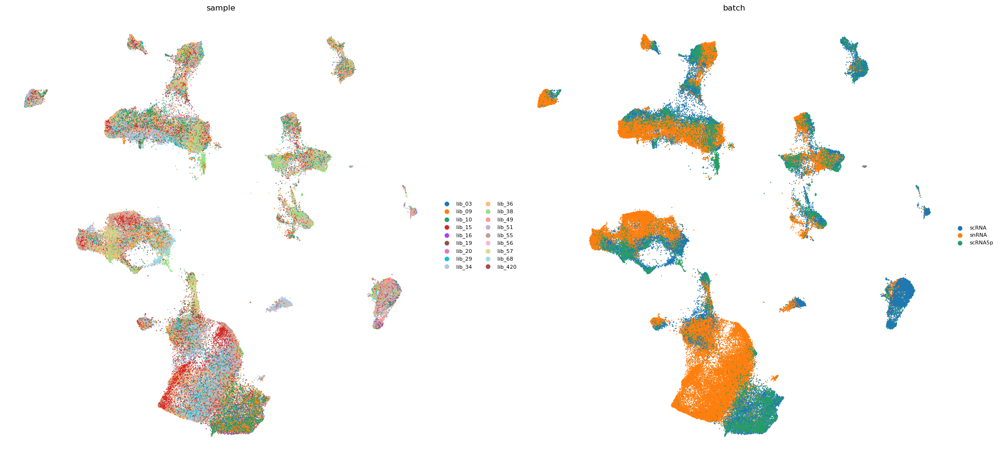

In [11]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample','batch'], size = 10,frameon=False,legend_fontsize=8, legend_fontoutline=2)

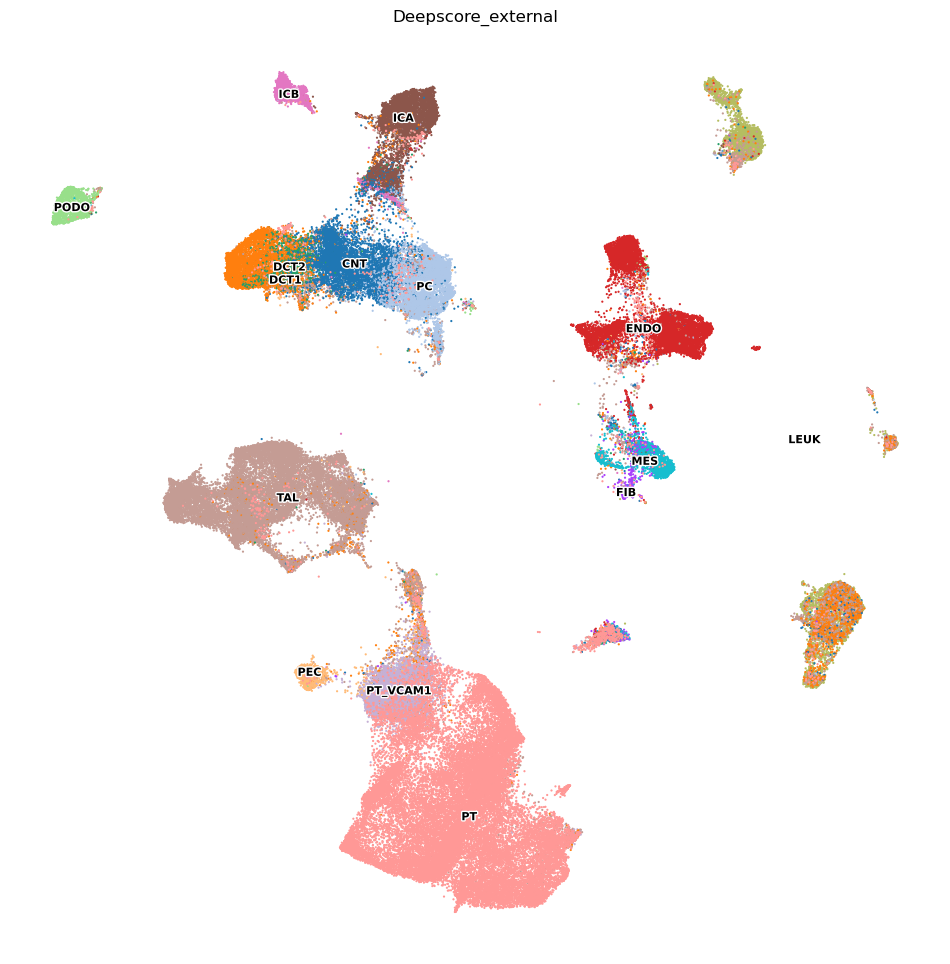

In [12]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external'], size = 10, palette = palette , legend_loc='on data', frameon=False,legend_fontsize=8, legend_fontoutline=2)

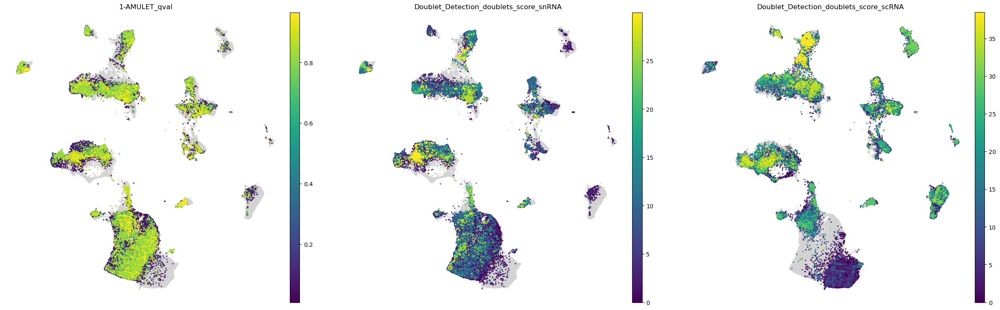

In [13]:
rcParams['figure.figsize'] = (9,9)
sc.pl.umap(adata, color = ['1-AMULET_qval','Doublet_Detection_doublets_score_snRNA','Doublet_Detection_doublets_score_scRNA'], size = 20, ncols=3,frameon=False, vmax='p99', groups=[True,'True'])

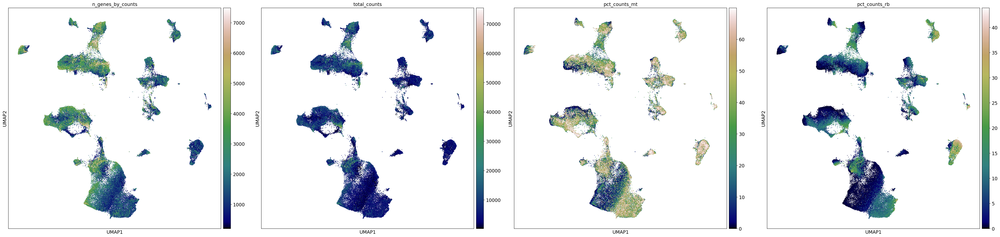

In [30]:
sc.pl.umap(adata, color = [ 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb'], size = 10)

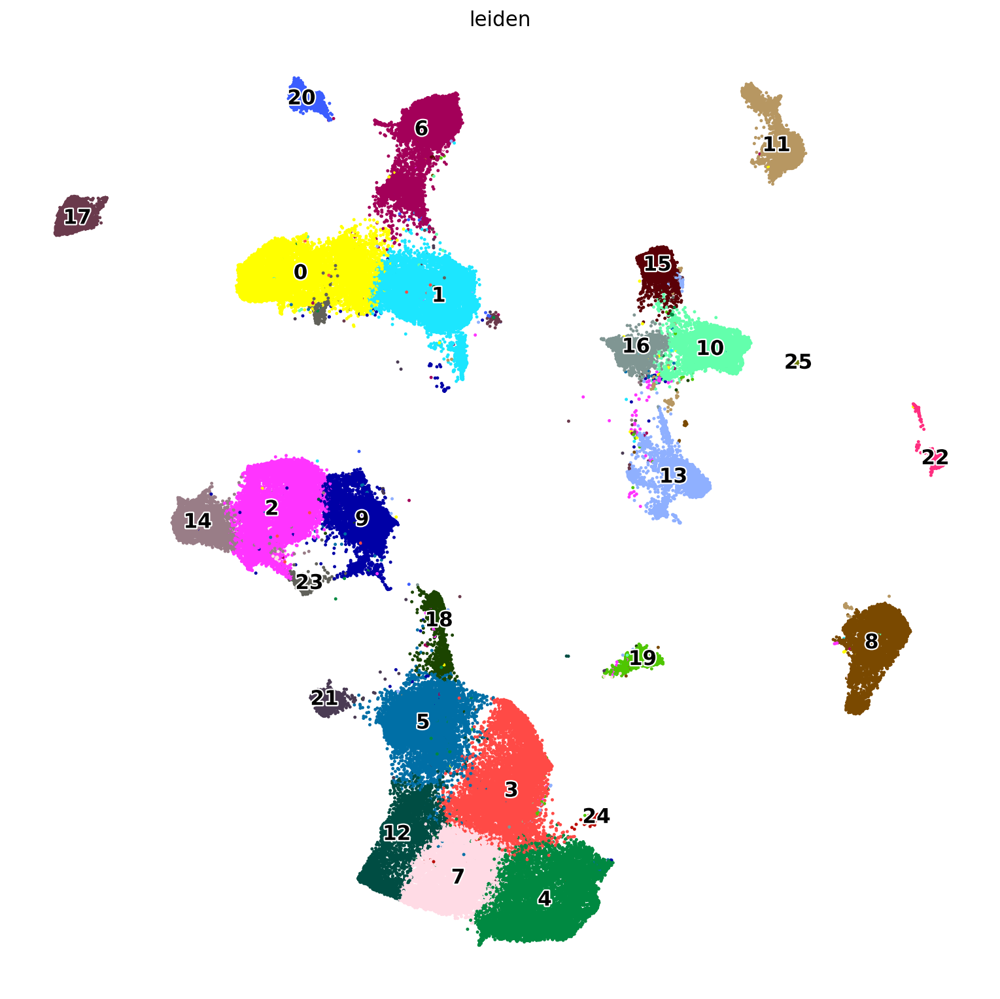

In [19]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['leiden'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data', legend_fontoutline = 2 )

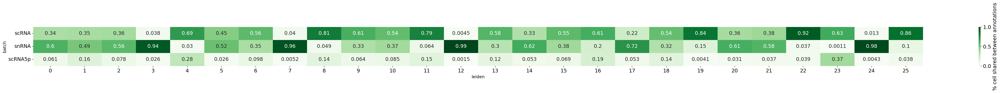

In [15]:
df_rna = comparison_heatmap_percent(adata, key1 = 'leiden', key2='batch', cmap = 'Greens',figsize=(55,2),)

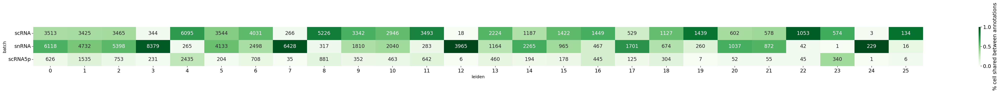

In [16]:
df_rna = comparison_heatmap(adata, key1 = 'leiden', key2='batch', cmap = 'Greens',figsize=(55,2),)

scRNA


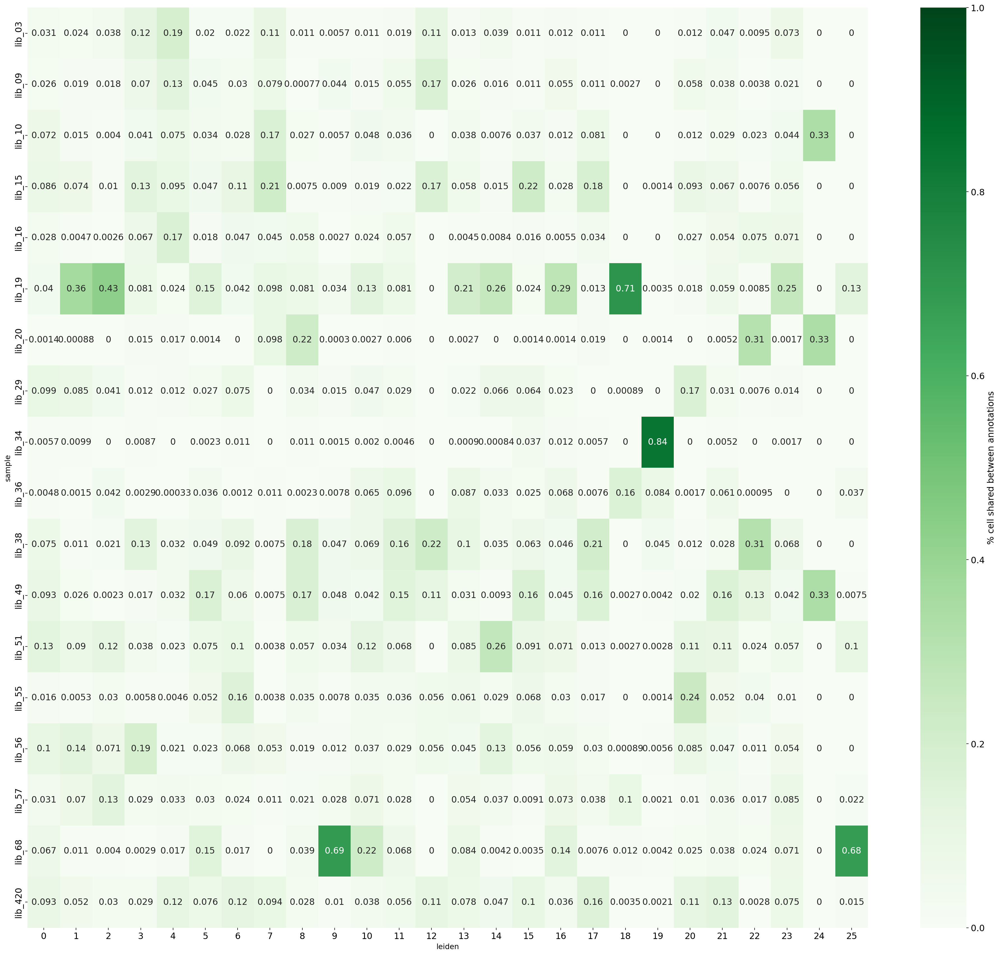

snRNA


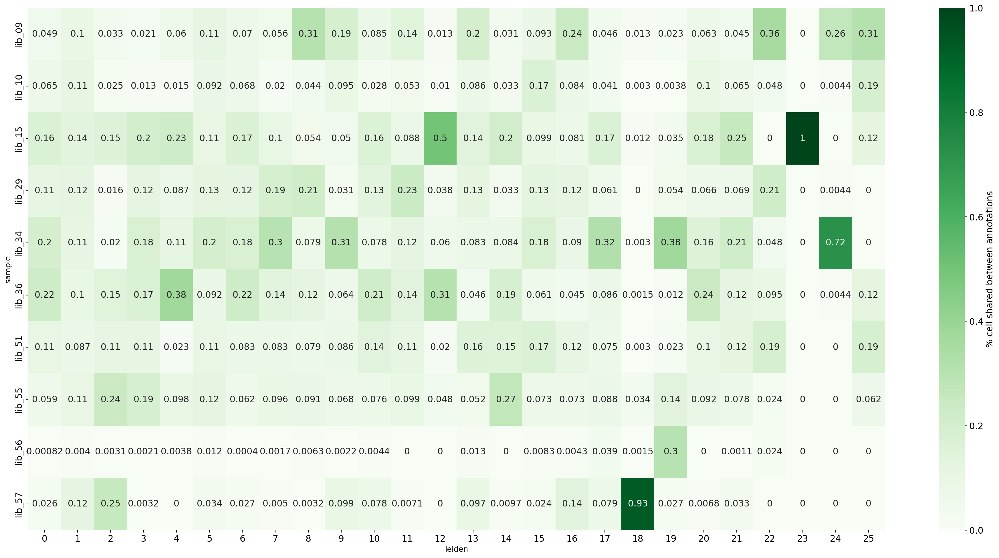

scRNA5p


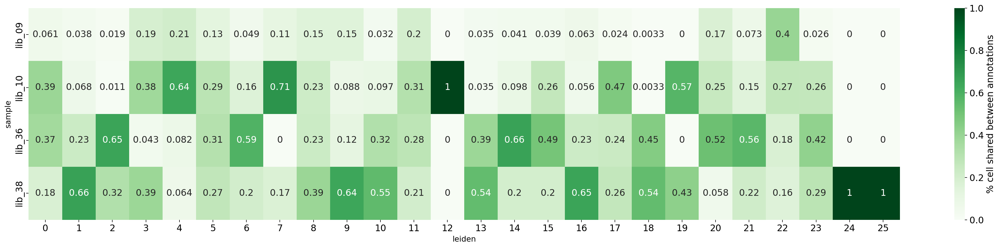

In [17]:
for cat in adata.obs['batch'].unique():
    print(cat)
    df_rna = comparison_heatmap_percent(adata[adata.obs['batch'].isin([cat])], key1 = 'leiden', key2='sample', cmap = 'Greens',figsize=(30,int(len(adata[adata.obs['batch'].isin([cat])].obs['sample'].unique())*1.5)),)
    plt.show()

scRNA


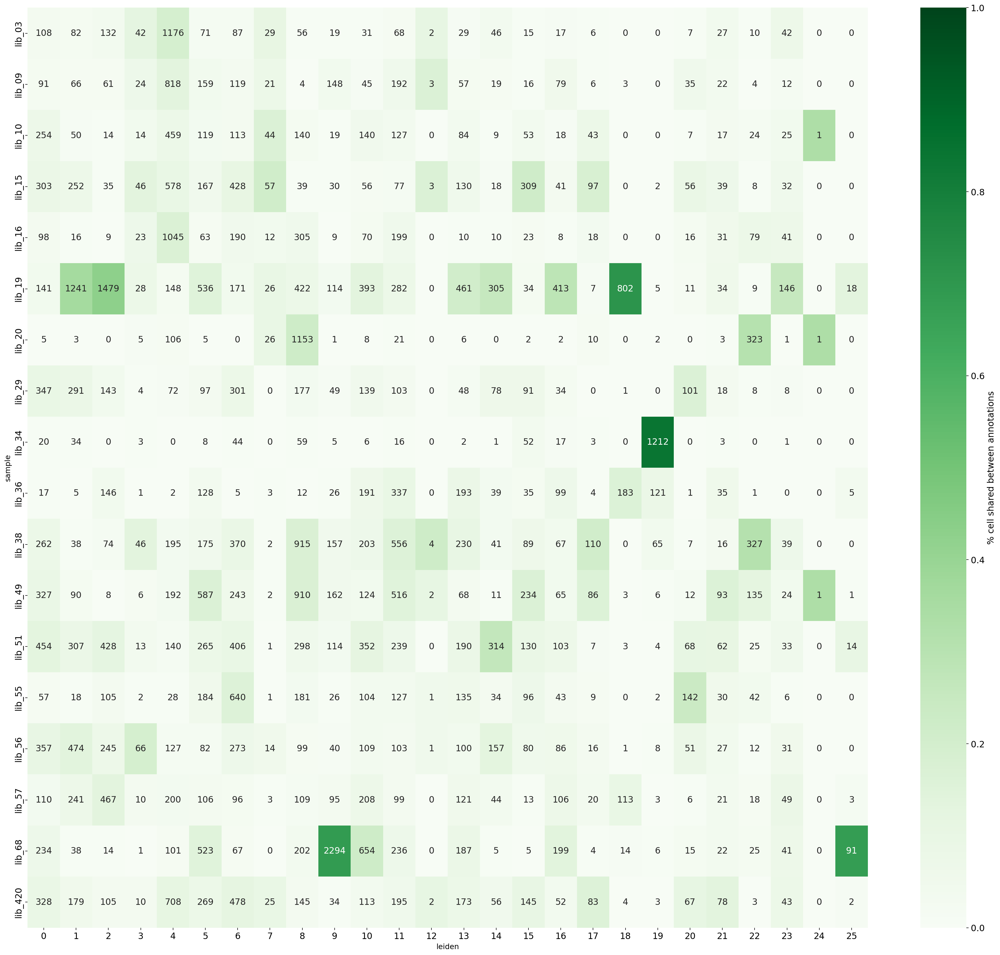

snRNA


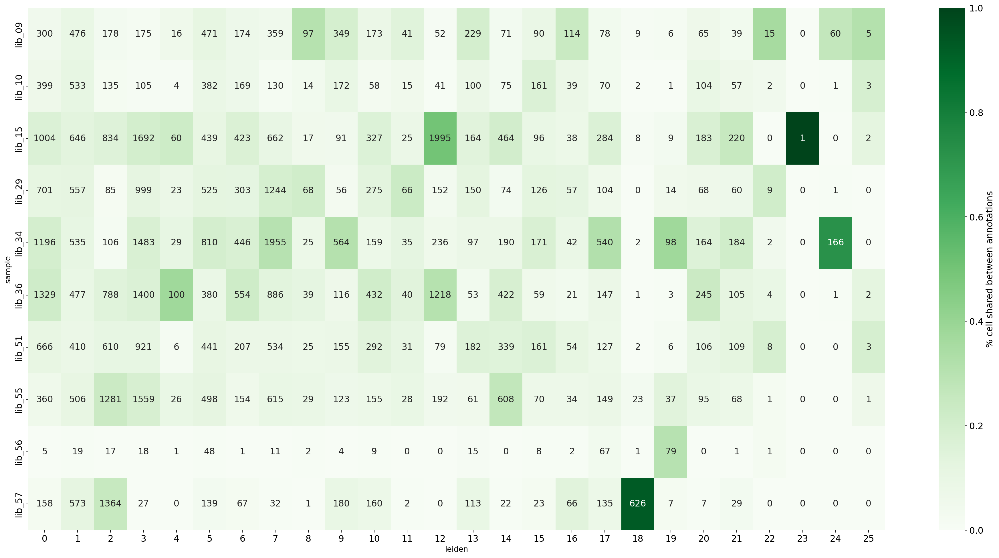

scRNA5p


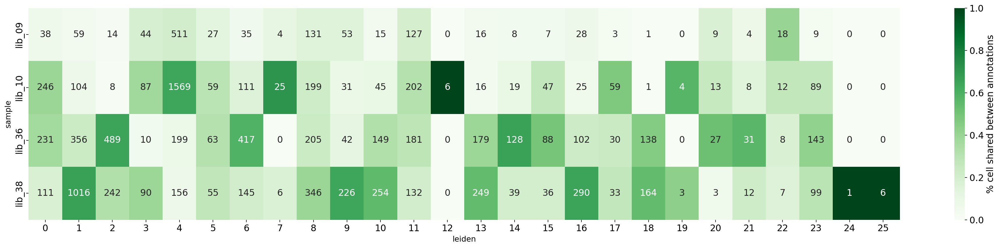

In [18]:
for cat in adata.obs['batch'].unique():
    print(cat)
    df_rna = comparison_heatmap(adata[adata.obs['batch'].isin([cat])], key1 = 'leiden', key2='sample', cmap = 'Greens',figsize=(30,int(len(adata[adata.obs['batch'].isin([cat])].obs['sample'].unique())*1.5)),)
    plt.show()

## COMPUTING MARKERS

In [20]:
hvg = adata.var.index.tolist()
adata = adata.raw.to_adata()
adata.var['highly_variable'] = [var in hvg for var in adata.var.index]
adata.raw = adata

In [21]:
adata.layers['counts'] = adata.X.copy()

In [22]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [23]:
sc.tl.rank_genes_groups(adata, method='wilcoxon', groupby='leiden')

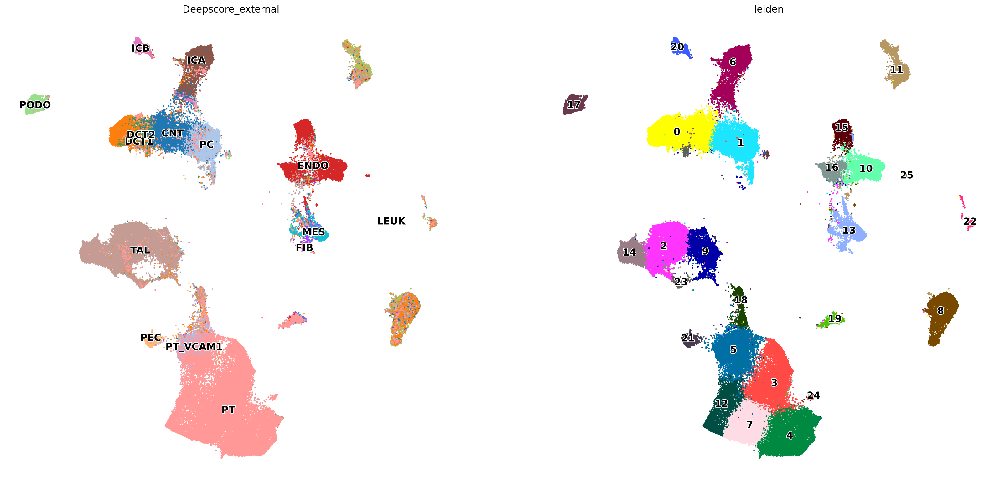

In [29]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external','leiden'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

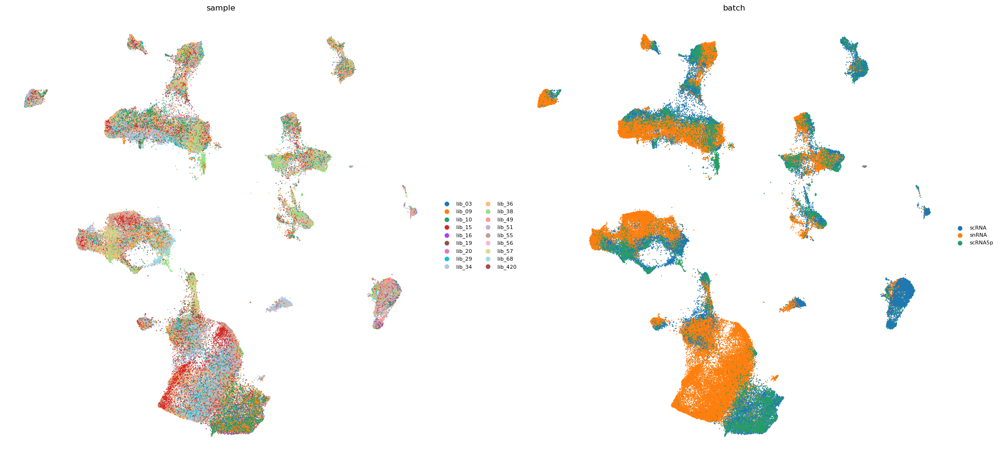

In [11]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample','batch'], size = 10,frameon=False,legend_fontsize=8, legend_fontoutline=2)

In [25]:
sc.tl.dendrogram(adata, use_rep='X_scVI', groupby='leiden')


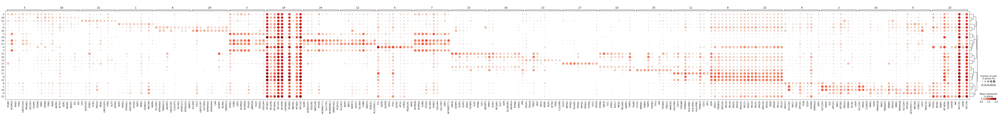

In [26]:
sc.pl.rank_genes_groups_dotplot(adata, vmax=5)

In [27]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']}).to_csv('markers/Global_RNA_Integrated_leiden_NEW.csv')

In [28]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']})

,0_n,0_s,0_p,0_l,1_n,1_s,1_p,1_l,2_n,2_s,...,23_p,23_l,24_n,24_s,24_p,24_l,25_n,25_s,25_p,25_l
0,WNK1,123.883743,0.0,3.144068,AQP2,124.718185,0.0,6.170745,SLC12A1,147.167755,...,0.000000e+00,3.508742,GLYAT,24.878866,4.816459e-132,4.988966,CCL21,17.452883,7.054566e-64,12.371588
1,TMEM52B,113.063896,0.0,4.117492,GATA3,104.468323,0.0,4.399848,UMOD,133.334198,...,1.048879e-290,3.479228,KCNQ1OT1,24.775829,2.447137e-131,5.128430,MMRN1,17.446012,7.054566e-64,10.916656
2,SLC12A3,109.017632,0.0,6.784192,ST6GAL1,101.284187,0.0,3.419146,EGF,120.304665,...,4.039454e-223,2.659513,GOLGB1,24.769308,2.447137e-131,4.970890,FABP4,16.730484,1.001416e-58,10.313199
3,ATP1B1,98.700500,0.0,2.078481,HSD11B2,100.164192,0.0,3.055718,ATP1A1,91.934425,...,1.394811e-214,2.383209,RNF212B,24.112513,1.765799e-124,6.582449,TIMP3,16.057722,4.823351e-54,3.966105
4,AC019197.1,98.598000,0.0,3.549366,FXYD4,100.033897,0.0,5.520509,KNG1,90.308792,...,4.237833e-212,2.425594,PTH2R,23.262674,8.094342e-116,4.049696,CAVIN2,15.576102,8.089164e-51,5.472965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38219,SLC16A12,-39.240391,0.0,-3.340926,SLC16A12,-41.909721,0.0,-4.042671,ACSM2B,-41.204170,...,6.715270e-144,-6.851538,MT-ND1,-15.017140,2.743489e-48,-2.602780,COBLL1,-9.072814,6.244062e-17,-4.966729
38220,ACSM2A,-40.506172,0.0,-3.531026,FXYD2,-46.853695,0.0,-1.993174,HLA-B,-41.256611,...,1.374367e-165,-4.311146,MT-ND4,-15.216111,1.409116e-49,-2.764778,MSI2,-9.144143,3.378567e-17,-4.668420
38221,NFIA,-46.320473,0.0,-2.755713,PTH1R,-48.906696,0.0,-3.158330,ACSM2A,-41.465034,...,3.988061e-179,-4.020763,MT-CYB,-15.326150,2.715059e-50,-2.601405,PKHD1,-9.670465,2.747639e-19,-5.501260
38222,ZBTB16,-58.968388,0.0,-3.619211,ZBTB16,-51.606529,0.0,-3.254214,TMSB4X,-57.680599,...,2.215498e-263,-5.294430,MT-ND2,-15.743370,4.417278e-53,-2.917331,ANK3,-9.789754,8.819768e-20,-5.836255


# LETs recluster the data with Higher Resolution

In [31]:
sc.tl.leiden(adata, key_added='leiden_finer', resolution=1.5)

In [32]:
sc.tl.rank_genes_groups(adata, method='wilcoxon', groupby='leiden_finer')

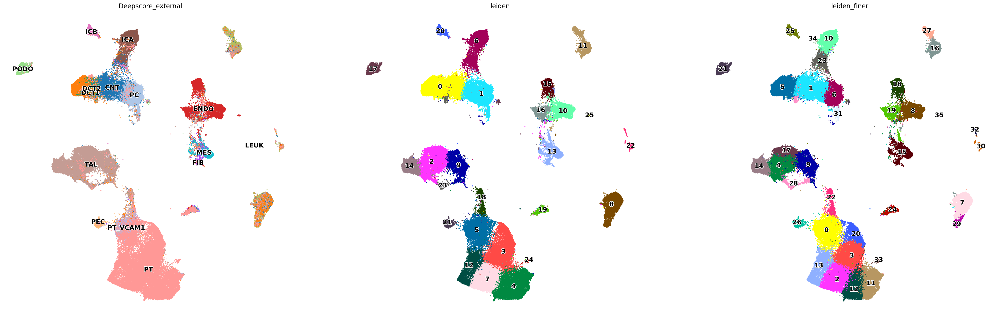

In [38]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external','leiden','leiden_finer'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

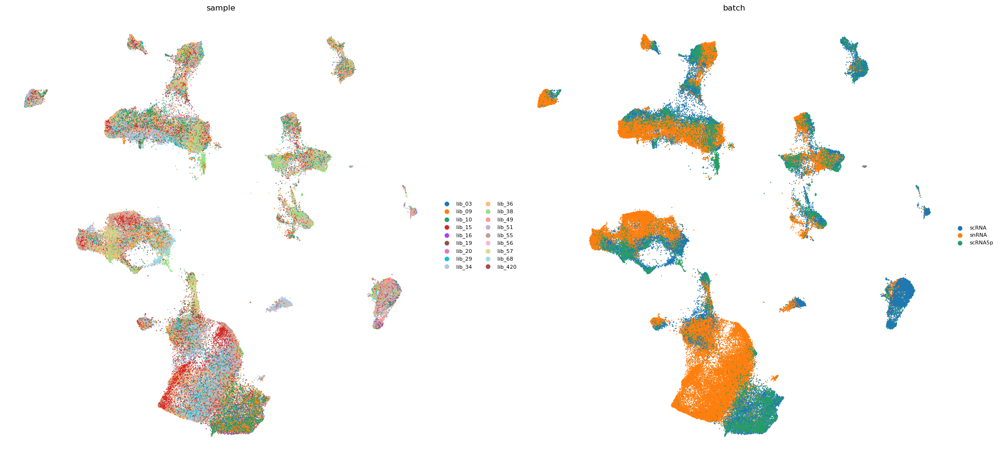

In [11]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample','batch'], size = 10,frameon=False,legend_fontsize=8, legend_fontoutline=2)

In [34]:
sc.tl.dendrogram(adata, use_rep='X_scVI', groupby='leiden')


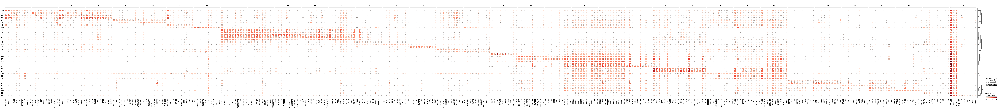

In [39]:
sc.pl.rank_genes_groups_dotplot(adata, vmax=5, min_logfoldchange=2)

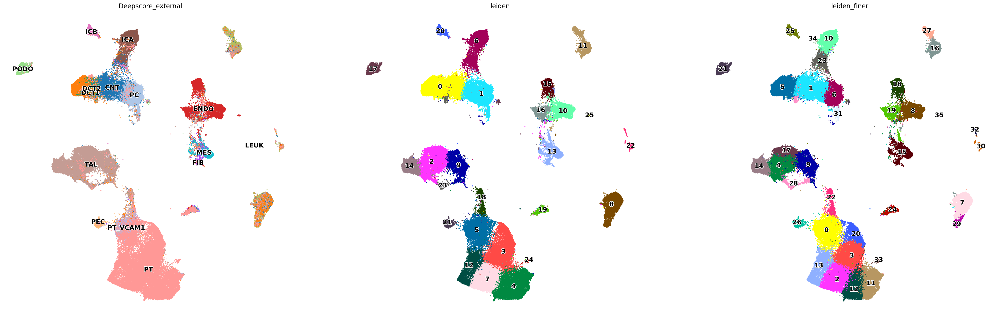

In [38]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external','leiden','leiden_finer'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

In [36]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']}).to_csv('markers/Global_RNA_Integrated_leiden_fines_NEW.csv')

In [37]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']})

,0_n,0_s,0_p,0_l,1_n,1_s,1_p,1_l,2_n,2_s,...,33_p,33_l,34_n,34_s,34_p,34_l,35_n,35_s,35_p,35_l
0,ITGB8,78.866150,0.000000e+00,2.934137,SLC8A1,105.698975,0.000000e+00,5.056394,ACSM2B,116.649994,...,2.154649e-131,4.985116,FXYD2,18.137566,3.077154e-69,3.413110,CCL21,17.452883,7.054566e-64,12.371588
1,ACSM2A,73.479691,0.000000e+00,2.000786,HSD11B2,95.028809,0.000000e+00,3.325769,ACSM2A,114.919029,...,1.076202e-130,5.121015,ATP6V1G3,16.592241,1.010452e-57,5.367920,MMRN1,17.446012,7.054566e-64,10.916656
2,RHEX,67.700500,0.000000e+00,3.721004,AC019197.1,89.612297,0.000000e+00,3.545712,CUBN,107.727165,...,1.076202e-130,4.967468,RPS24,16.480045,4.877935e-57,2.460650,FABP4,16.730484,1.001416e-58,10.313199
3,TPM1,67.058319,0.000000e+00,2.459206,PIK3C2G,87.172523,0.000000e+00,3.643667,PTH2R,99.989456,...,7.550722e-124,6.582375,C12orf75,16.309050,6.506305e-56,3.917642,TIMP3,16.057722,4.823351e-54,3.966105
4,LINC01320,65.937553,0.000000e+00,1.950283,WSB1,84.659515,0.000000e+00,2.225045,SLC4A4,93.561066,...,3.556574e-115,4.043220,EEF1A1,15.792882,1.901908e-52,2.356542,CAVIN2,15.576102,8.089164e-51,5.472965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38219,AC019197.1,-30.163177,2.040281e-197,-2.903526,ACSM2B,-32.694809,2.640006e-232,-3.645036,RPLP1,-66.557922,...,7.452400e-48,-2.592737,DDX17,-12.247755,1.269556e-31,-3.266142,COBLL1,-9.072814,6.244062e-17,-4.966729
38220,CA12,-30.680658,3.128081e-204,-1.867200,ACSM2A,-33.676010,1.992548e-246,-3.676461,RPL41,-67.536751,...,2.164671e-49,-2.767453,ZBTB20,-13.415041,7.547879e-38,-5.233512,MSI2,-9.144143,3.378567e-17,-4.668420
38221,PTGER3,-36.617847,6.610667e-291,-3.257484,SLC16A12,-35.509003,6.528574e-274,-3.969712,RPL10,-67.722137,...,7.761751e-50,-2.589485,SYNE2,-14.454444,6.416738e-44,-5.559983,PKHD1,-9.670465,2.747639e-19,-5.501260
38222,ERBB4,-37.001244,5.036411e-297,-3.233898,ZBTB16,-44.201523,0.000000e+00,-3.178324,MT-ND3,-67.948616,...,1.203685e-52,-2.907480,NEAT1,-15.828744,1.255766e-52,-4.821903,ANK3,-9.789754,8.819768e-20,-5.836255


## COMPUTING MARKERS WITH SHARED GENES

In [40]:
n_samples = adata.obs['sample'].nunique()
n_batches = adata.obs['batch'].nunique()

# Initialize a dictionary to store the count of gene presence in each sample/batch
gene_sets = []

# Loop over each sample/batch
# for sample in adata.obs['sample'].unique():
for batch in adata.obs['batch'].unique():
    # Subset the data for the current sample and batch
    subset_adata = adata[adata.obs['batch'] == batch]

    # Get the genes expressed in the current sample/batch
    genes_expressed = set(subset_adata.var_names[np.array(subset_adata.X.sum(axis=0) > 0)[0]])
    if len(subset_adata.var_names[np.array(subset_adata.X.sum(axis=0) > 0)[0]]) != 0:

    # Add the gene set to the list
        gene_sets.append(genes_expressed)

# Perform the intersection of gene sets
genes_to_keep = set.intersection(*gene_sets)

# Subset the data to keep only the genes present in every sample/batch


In [41]:
len(list(genes_to_keep))

29501

In [42]:
adata = adata[:, list(genes_to_keep)]

In [44]:
sc.tl.rank_genes_groups(adata, method='wilcoxon', groupby='leiden')

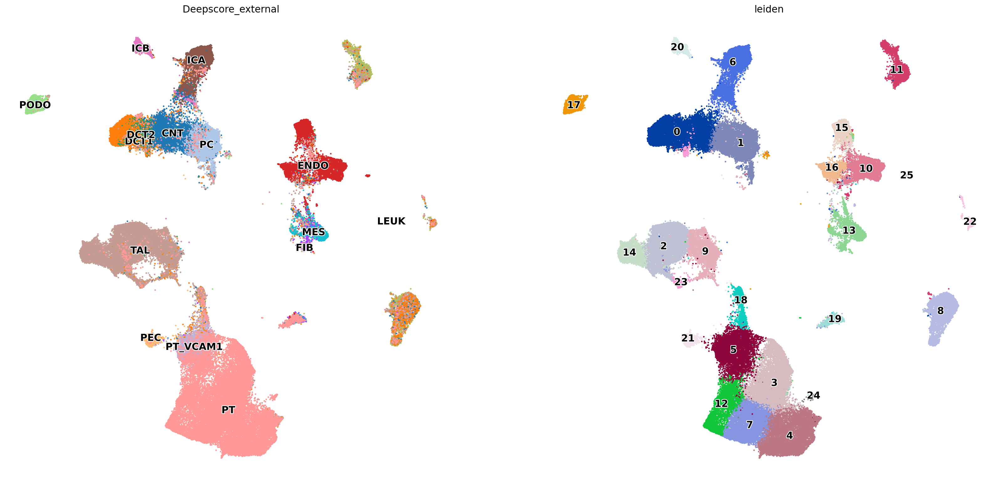

In [45]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external','leiden'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

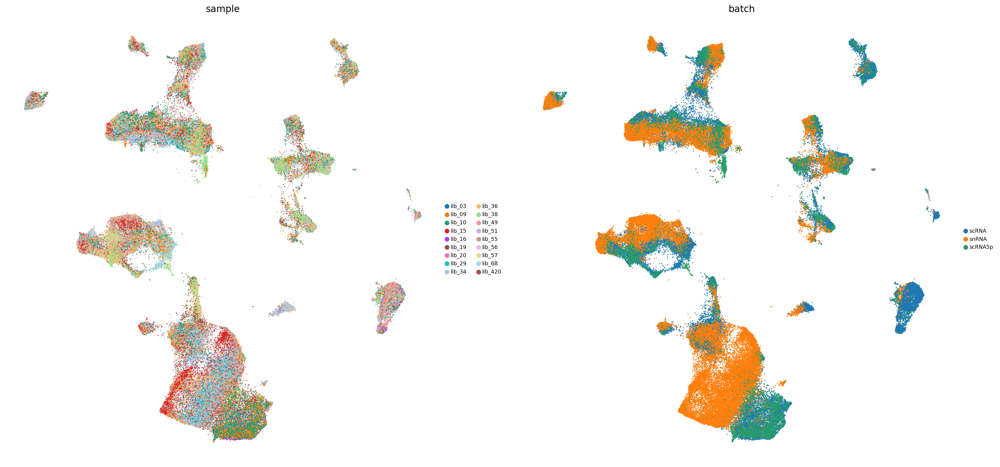

In [46]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample','batch'], size = 10,frameon=False,legend_fontsize=8, legend_fontoutline=2)

In [47]:
sc.tl.dendrogram(adata, use_rep='X_scVI', groupby='leiden')


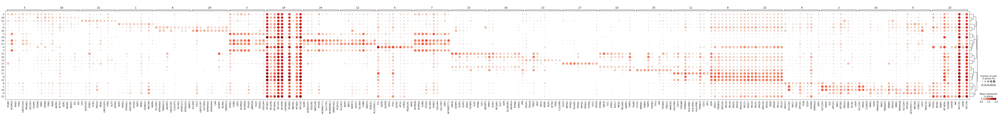

In [48]:
sc.pl.rank_genes_groups_dotplot(adata, vmax=5)

In [49]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']}).to_csv('markers/Global_RNA_Integrated_leiden_NEW_shared.csv')

In [50]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']})

,0_n,0_s,0_p,0_l,1_n,1_s,1_p,1_l,2_n,2_s,...,23_p,23_l,24_n,24_s,24_p,24_l,25_n,25_s,25_p,25_l
0,WNK1,123.883743,0.0,3.144068,AQP2,124.718185,0.0,6.170745,SLC12A1,147.167755,...,0.000000e+00,3.508742,GLYAT,24.878866,4.816459e-132,4.988966,CCL21,17.452883,7.054566e-64,12.371588
1,TMEM52B,113.063896,0.0,4.117492,GATA3,104.468323,0.0,4.399848,UMOD,133.334198,...,1.048879e-290,3.479228,KCNQ1OT1,24.775829,2.447137e-131,5.128430,MMRN1,17.446012,7.054566e-64,10.916656
2,SLC12A3,109.017632,0.0,6.784192,ST6GAL1,101.284187,0.0,3.419146,EGF,120.304665,...,4.039454e-223,2.659513,GOLGB1,24.769308,2.447137e-131,4.970890,FABP4,16.730484,1.001416e-58,10.313199
3,ATP1B1,98.700500,0.0,2.078481,HSD11B2,100.164192,0.0,3.055718,ATP1A1,91.934425,...,1.394811e-214,2.383209,RNF212B,24.112513,1.765799e-124,6.582449,TIMP3,16.057722,4.823351e-54,3.966105
4,AC019197.1,98.598000,0.0,3.549366,FXYD4,100.033897,0.0,5.520509,KNG1,90.308792,...,4.237833e-212,2.425594,PTH2R,23.262674,8.094342e-116,4.049696,CAVIN2,15.576102,8.089164e-51,5.472965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38219,SLC16A12,-39.240391,0.0,-3.340926,SLC16A12,-41.909721,0.0,-4.042671,ACSM2B,-41.204170,...,6.715270e-144,-6.851538,MT-ND1,-15.017140,2.743489e-48,-2.602780,COBLL1,-9.072814,6.244062e-17,-4.966729
38220,ACSM2A,-40.506172,0.0,-3.531026,FXYD2,-46.853695,0.0,-1.993174,HLA-B,-41.256611,...,1.374367e-165,-4.311146,MT-ND4,-15.216111,1.409116e-49,-2.764778,MSI2,-9.144143,3.378567e-17,-4.668420
38221,NFIA,-46.320473,0.0,-2.755713,PTH1R,-48.906696,0.0,-3.158330,ACSM2A,-41.465034,...,3.988061e-179,-4.020763,MT-CYB,-15.326150,2.715059e-50,-2.601405,PKHD1,-9.670465,2.747639e-19,-5.501260
38222,ZBTB16,-58.968388,0.0,-3.619211,ZBTB16,-51.606529,0.0,-3.254214,TMSB4X,-57.680599,...,2.215498e-263,-5.294430,MT-ND2,-15.743370,4.417278e-53,-2.917331,ANK3,-9.789754,8.819768e-20,-5.836255


In [51]:
sc.tl.rank_genes_groups(adata, method='wilcoxon', groupby='leiden_finer')

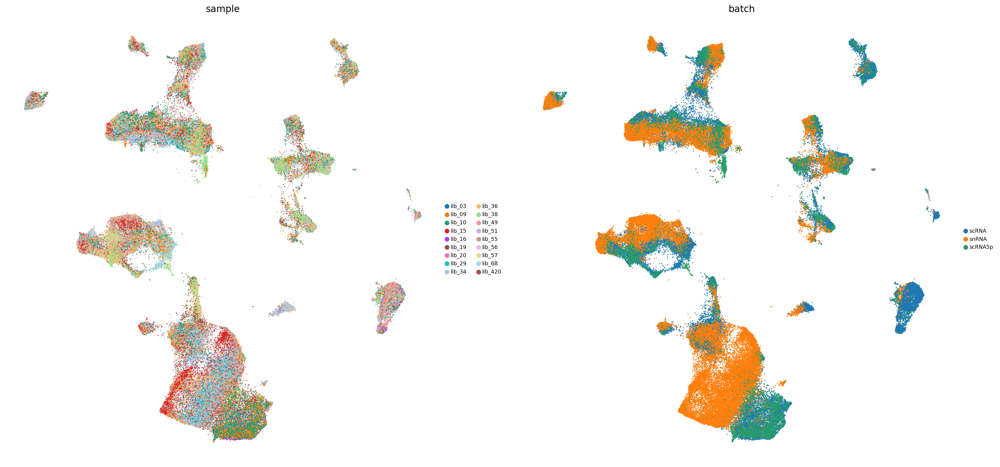

In [53]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample','batch'], size = 10,frameon=False,legend_fontsize=8, legend_fontoutline=2)

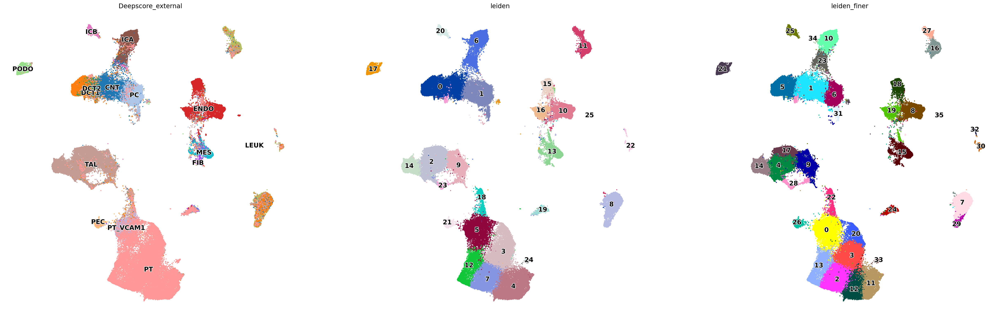

In [52]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['Deepscore_external','leiden','leiden_finer'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

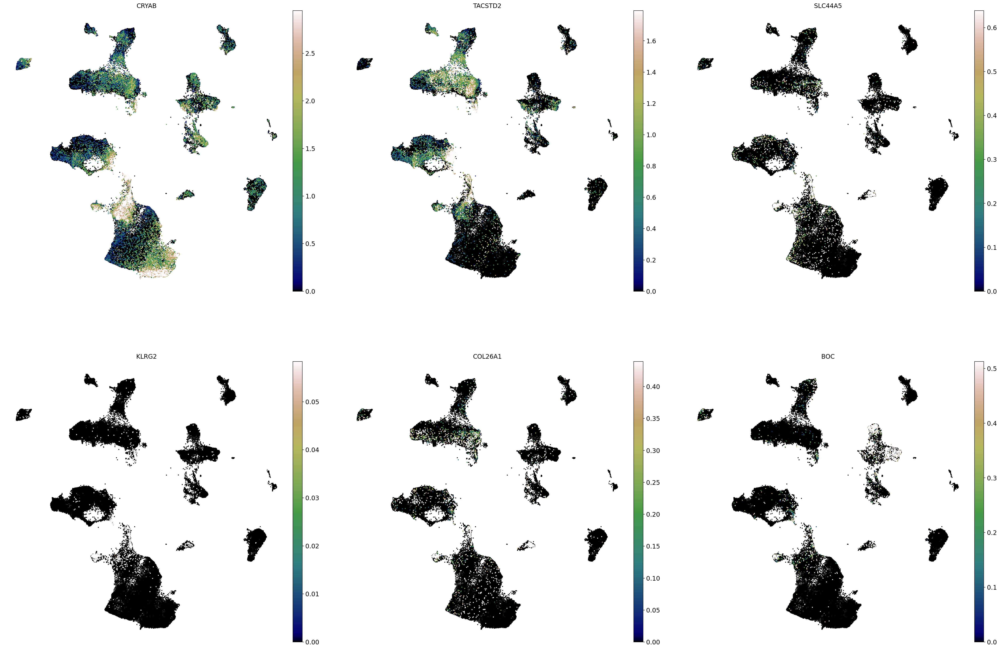

In [72]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['CRYAB', 'TACSTD2', 'SLC44A5', 'KLRG2', 'COL26A1', 'BOC'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 )

In [54]:
sc.tl.dendrogram(adata, use_rep='X_scVI', groupby='leiden_finer')


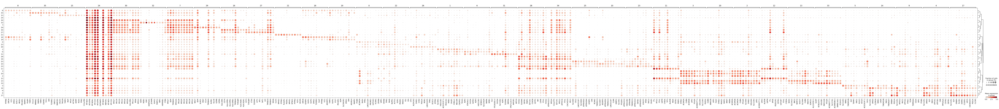

In [62]:
sc.pl.rank_genes_groups_dotplot(adata, vmax=5)

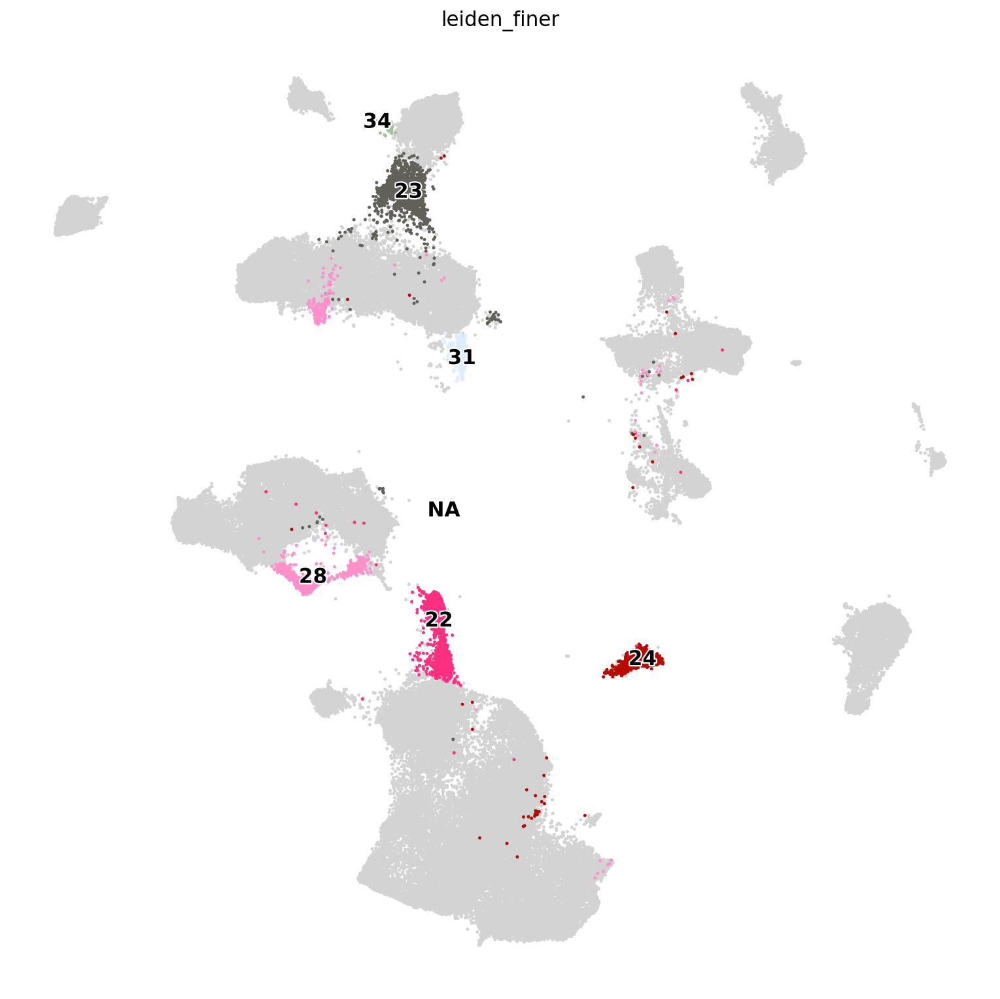

In [76]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['leiden_finer'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 , groups=['24','31','22','28','34','23'])

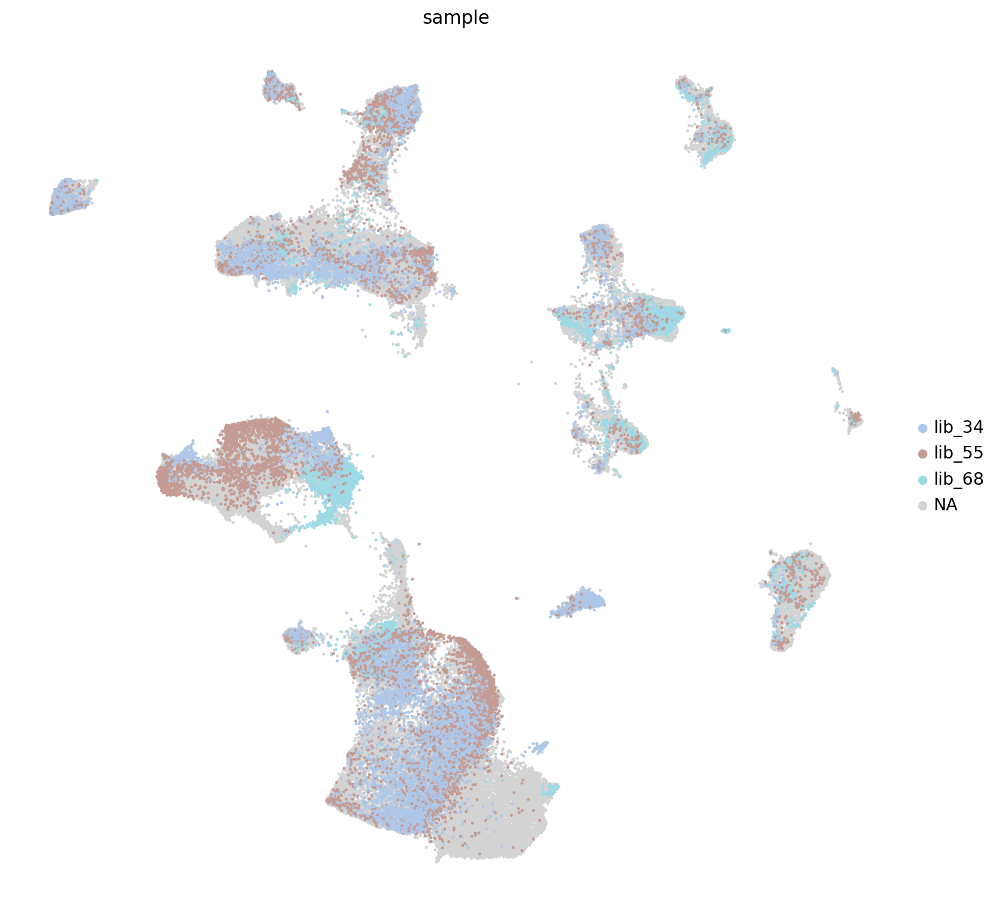

In [71]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample'],frameon=False, size = 20, ncols=3, vmax='p99',   legend_fontoutline = 2 , groups=['lib_68','lib_34','lib_55'])

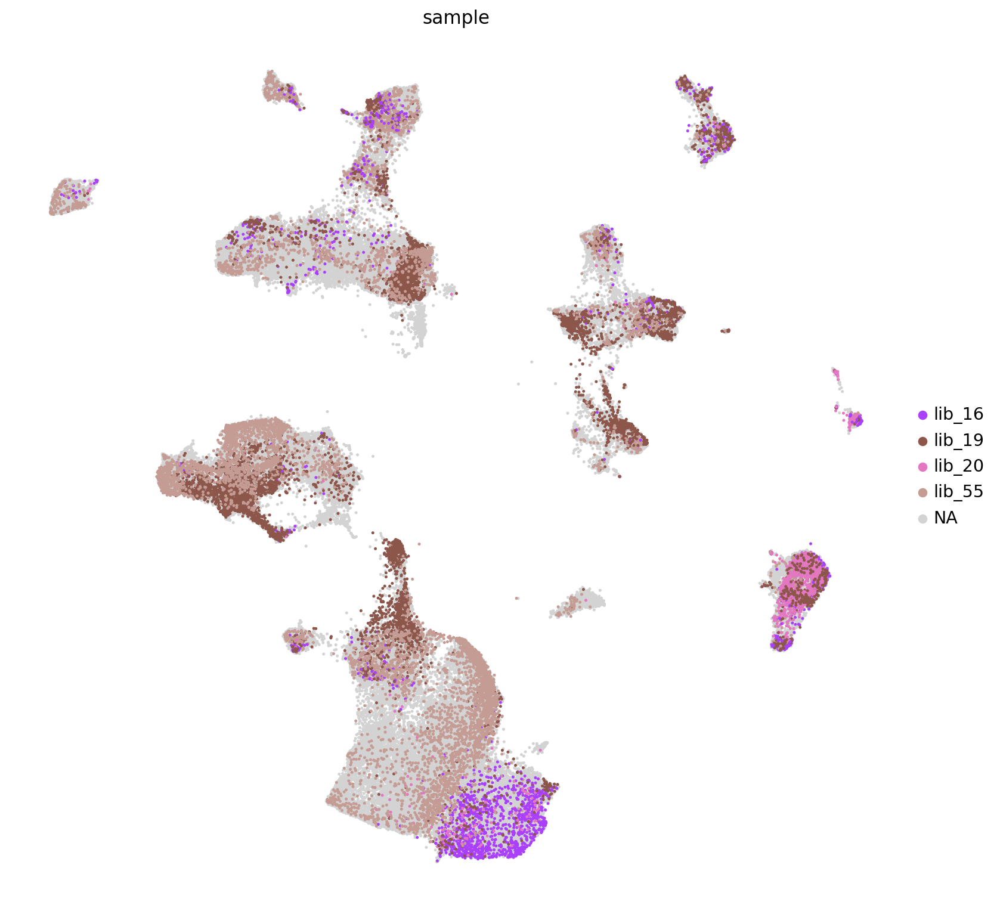

In [70]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample'],frameon=False, size = 20, ncols=3, vmax='p99',  legend_fontoutline = 2 , groups=['lib_20','lib_19','lib_16','lib_55'])

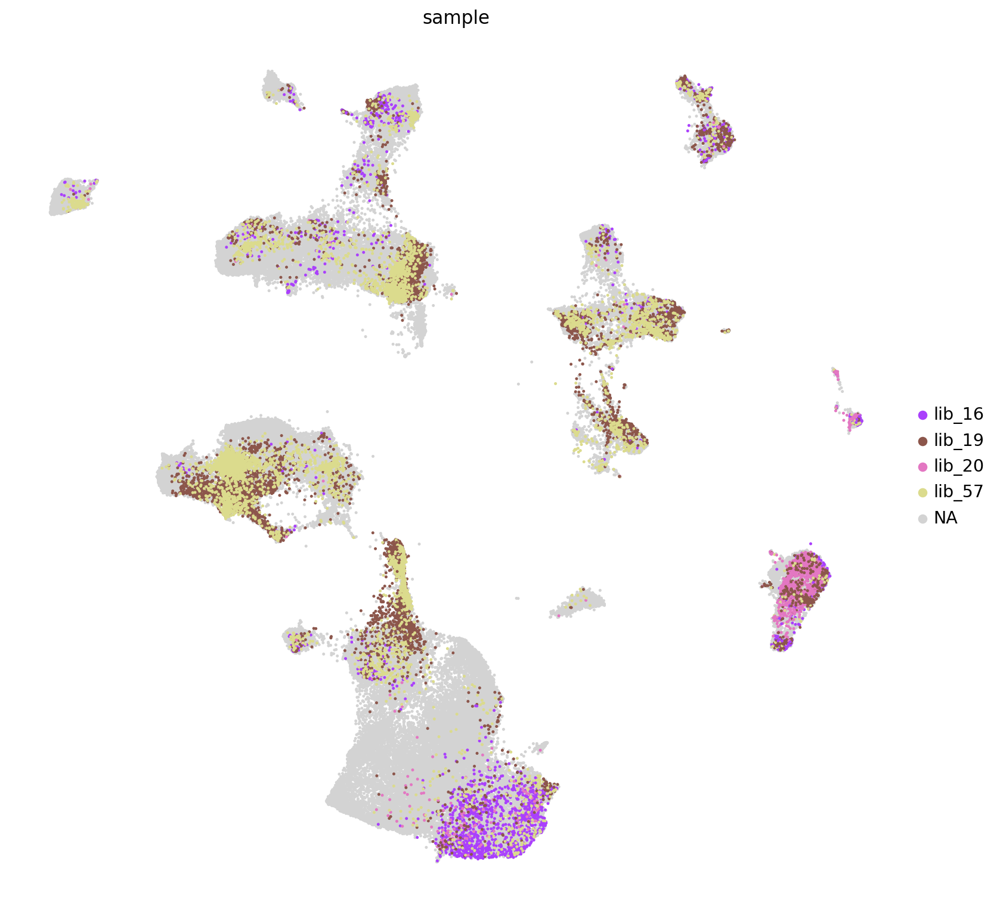

In [73]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['sample'],frameon=False, size = 20, ncols=3, vmax='p99',  legend_fontoutline = 2 , groups=['lib_20','lib_19','lib_16','lib_57'])

scRNA


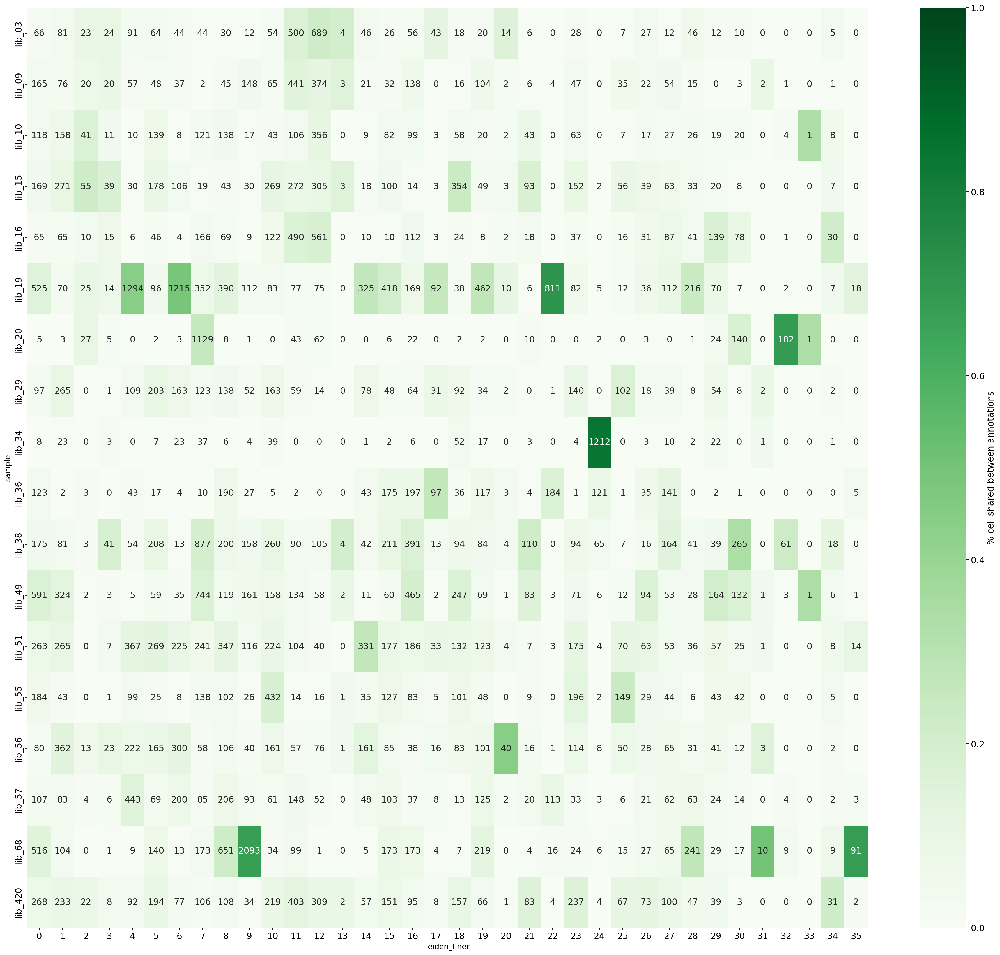

snRNA


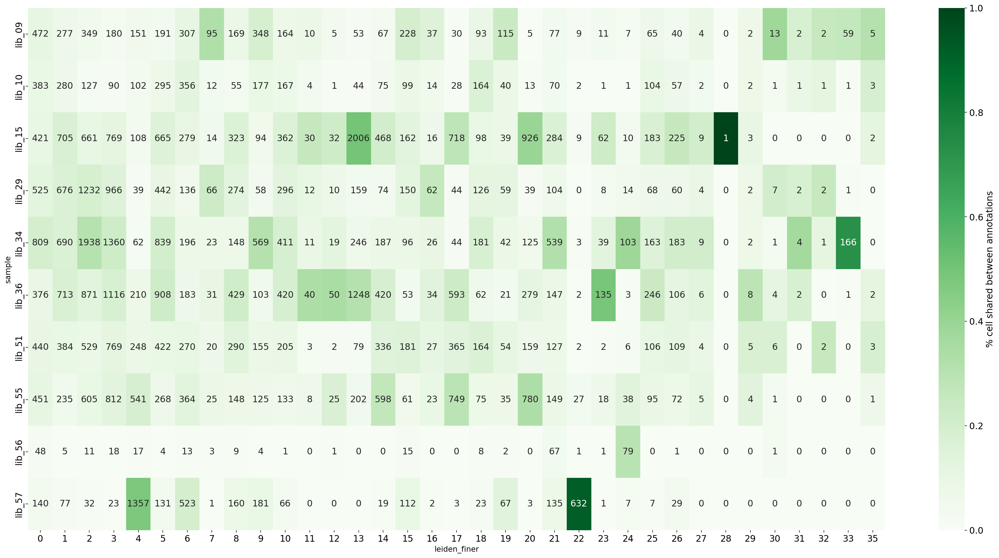

scRNA5p


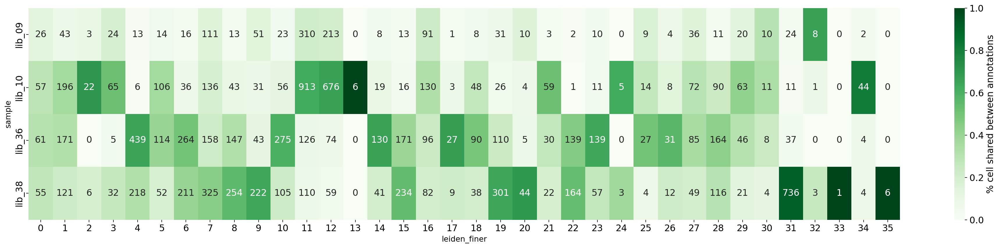

In [65]:
for cat in adata.obs['batch'].unique():
    print(cat)
    df_rna = comparison_heatmap(adata[adata.obs['batch'].isin([cat])], key1 = 'leiden_finer', key2='sample', cmap = 'Greens',figsize=(30,int(len(adata[adata.obs['batch'].isin([cat])].obs['sample'].unique())*1.5)),)
    plt.show()

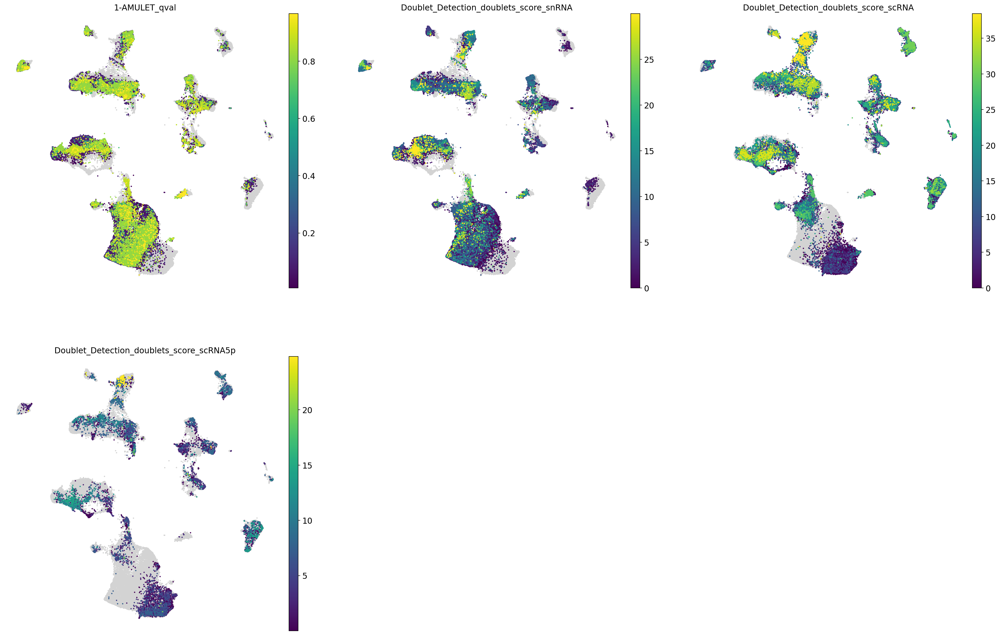

In [78]:
rcParams['figure.figsize'] = (9,9)
sc.pl.umap(adata, color = ['1-AMULET_qval','Doublet_Detection_doublets_score_snRNA','Doublet_Detection_doublets_score_scRNA','Doublet_Detection_doublets_score_scRNA5p'], size = 20,cmap ='viridis', ncols=3,frameon=False, vmax='p99', groups=[True,'True'])

In [57]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']}).to_csv('markers/Global_RNA_Integrated_leiden_fines_NEW_shared.csv')

In [58]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores','pvals','pvals_adj','logfoldchanges']})

,0_n,0_s,0_p,0_l,1_n,1_s,1_p,1_l,2_n,2_s,...,33_p,33_l,34_n,34_s,34_p,34_l,35_n,35_s,35_p,35_l
0,ITGB8,78.866150,0.000000e+00,2.934137,SLC8A1,105.698975,0.000000e+00,5.056394,ACSM2B,116.649994,...,2.154649e-131,4.985116,FXYD2,18.137566,3.077154e-69,3.413110,CCL21,17.452883,7.054566e-64,12.371588
1,ACSM2A,73.479691,0.000000e+00,2.000786,HSD11B2,95.028809,0.000000e+00,3.325769,ACSM2A,114.919029,...,1.076202e-130,5.121015,ATP6V1G3,16.592241,1.010452e-57,5.367920,MMRN1,17.446012,7.054566e-64,10.916656
2,RHEX,67.700500,0.000000e+00,3.721004,AC019197.1,89.612297,0.000000e+00,3.545712,CUBN,107.727165,...,1.076202e-130,4.967468,RPS24,16.480045,4.877935e-57,2.460650,FABP4,16.730484,1.001416e-58,10.313199
3,TPM1,67.058319,0.000000e+00,2.459206,PIK3C2G,87.172523,0.000000e+00,3.643667,PTH2R,99.989456,...,7.550722e-124,6.582375,C12orf75,16.309050,6.506305e-56,3.917642,TIMP3,16.057722,4.823351e-54,3.966105
4,LINC01320,65.937553,0.000000e+00,1.950283,WSB1,84.659515,0.000000e+00,2.225045,SLC4A4,93.561066,...,3.556574e-115,4.043220,EEF1A1,15.792882,1.901908e-52,2.356542,CAVIN2,15.576102,8.089164e-51,5.472965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38219,AC019197.1,-30.163177,2.040281e-197,-2.903526,ACSM2B,-32.694809,2.640006e-232,-3.645036,RPLP1,-66.557922,...,7.452400e-48,-2.592737,DDX17,-12.247755,1.269556e-31,-3.266142,COBLL1,-9.072814,6.244062e-17,-4.966729
38220,CA12,-30.680658,3.128081e-204,-1.867200,ACSM2A,-33.676010,1.992548e-246,-3.676461,RPL41,-67.536751,...,2.164671e-49,-2.767453,ZBTB20,-13.415041,7.547879e-38,-5.233512,MSI2,-9.144143,3.378567e-17,-4.668420
38221,PTGER3,-36.617847,6.610667e-291,-3.257484,SLC16A12,-35.509003,6.528574e-274,-3.969712,RPL10,-67.722137,...,7.761751e-50,-2.589485,SYNE2,-14.454444,6.416738e-44,-5.559983,PKHD1,-9.670465,2.747639e-19,-5.501260
38222,ERBB4,-37.001244,5.036411e-297,-3.233898,ZBTB16,-44.201523,0.000000e+00,-3.178324,MT-ND3,-67.948616,...,1.203685e-52,-2.907480,NEAT1,-15.828744,1.255766e-52,-4.821903,ANK3,-9.789754,8.819768e-20,-5.836255


In [80]:
adata.write('objects/Integration_scVI_preClean.h5ad')
adata

AnnData object with n_obs × n_vars = 119171 × 29501
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external', 'Doublet_Detection_doublets_scRNA', 'Doublet_Detection_doublets_score_scRNA', 'Doublet_Detection_doublets_scRNA5p', 'Doublet_Detection_doublets_score_scRNA5p', 'AMULET_doublets', 'AMULET_pval', 'AMULET_qval', 'Doublet_Detection_doublets_snRNA', 'Doublet_Detection_doublets_score_snRNA', '1-AMULET_qval', 'total_counts_mt_rb', 'pct_counts_mt_rb', '_scvi_batch', '_scvi_labels', 'leiden', 'leiden_finer'
    var: 'highly_variable'
    uns: 'Deepscore_external_colors', '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'sample_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'dendrogram_leiden_finer', 'leiden_finer_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    varm: 'PCs'


## DETECT & FILTER OUT Low Quality Clusters

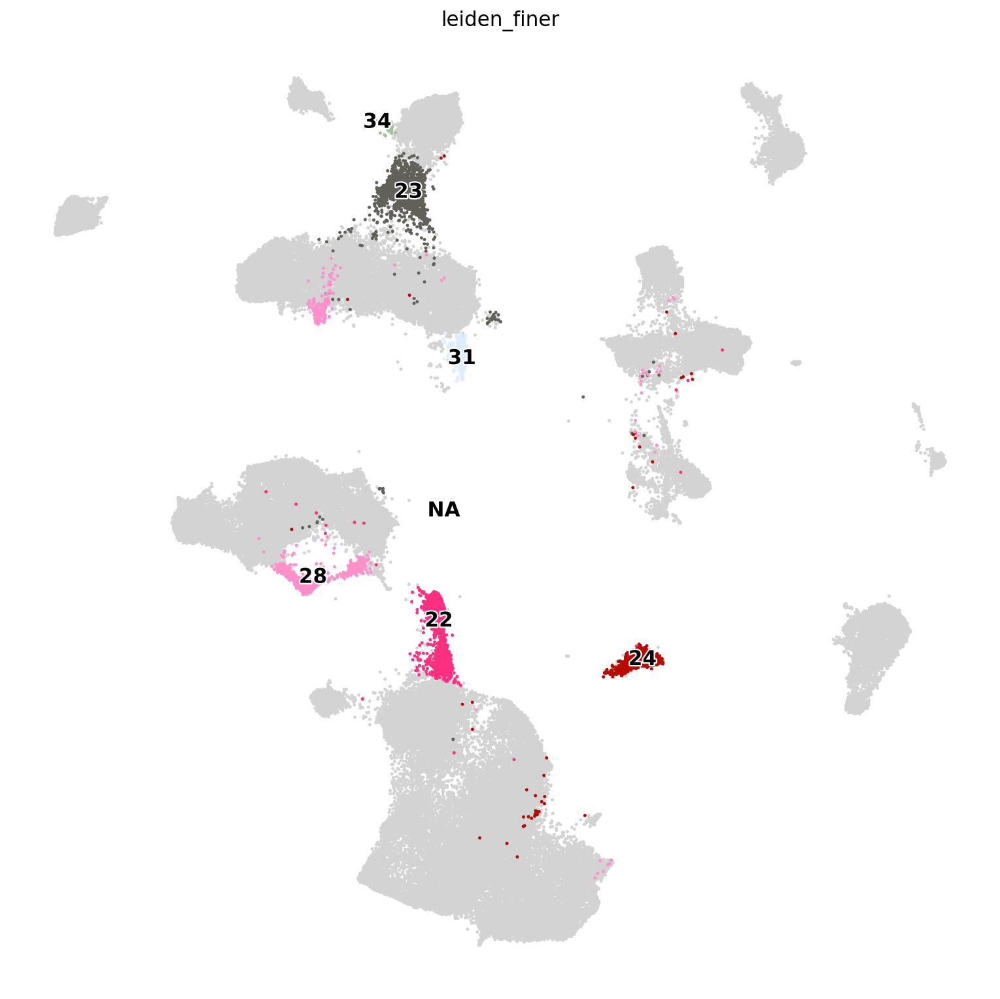

In [76]:
rcParams['figure.figsize'] = (12,12)
sc.pl.umap(adata, color = ['leiden_finer'],frameon=False, size = 20, ncols=3, vmax='p99', legend_loc='on data',  legend_fontoutline = 2 , groups=['24','31','22','28','34','23'])

In [ ]:
adata[~adata.obs['leiden_finer'].isin(['24','31','22','28','34','23'])].write('objects/Integration_scVI_Clean.h5ad')

In [85]:
adata = adata[~adata.obs['leiden_finer'].isin(['24','31','22','28','34','23'])]
adata

View of AnnData object with n_obs × n_vars = 111031 × 29501
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external', 'Doublet_Detection_doublets_scRNA', 'Doublet_Detection_doublets_score_scRNA', 'Doublet_Detection_doublets_scRNA5p', 'Doublet_Detection_doublets_score_scRNA5p', 'AMULET_doublets', 'AMULET_pval', 'AMULET_qval', 'Doublet_Detection_doublets_snRNA', 'Doublet_Detection_doublets_score_snRNA', '1-AMULET_qval', 'total_counts_mt_rb', 'pct_counts_mt_rb', '_scvi_batch', '_scvi_labels', 'leiden', 'leiden_finer'
    var: 'highly_variable'
    uns: 'Deepscore_external_colors', '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'dendrogram_leiden', 'dendrogram_leiden_finer', 'leiden', 'leiden_colors', 'leiden_finer_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    varm